In [4]:
import sys
import collections
import numpy as np
from scipy.signal import savgol_filter, convolve, normalize
import IPython.display as ipd
import matplotlib.pyplot as plt
import librosa
import time
from itertools import permutations 
# Allows me to import my modules
sys.path.append('./modules')
from audio_utils import *

Attempting to read settings file...
	Read successfully!


In [6]:
data = get_sample_data(data_type="cropped")

In [3]:
len(data)

335

In [10]:
data[0].labels

{'hit_label': 'beater', 'kit_label': 'bass_drum', 'tech_label': 'normal'}

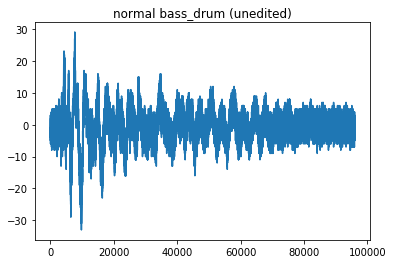

In [12]:
plt.plot(data[0].data)
plt.title("{} {} (unedited)".format(data[0].labels["tech_label"], data[0].labels["kit_label"]))
plt.show()

In [13]:
ipd.Audio(data[0].data, rate=data[0].rate)

In [17]:
np.random.randn(10)

array([-0.50391523, -1.84341271, -0.78653692,  0.70647158,  2.33848489,
       -0.6104361 ,  1.38200737, -0.81284502,  0.47054018,  0.20117797])

In [64]:
def white_noise(amount, mu, sigma_squared):
    return sigma_squared*np.random.randn(amount)+mu

In [20]:
data_len = len(data[0].data)

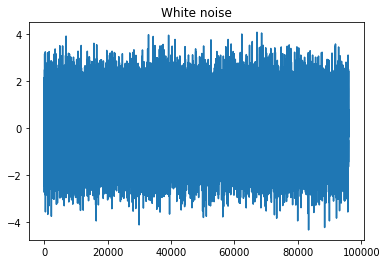

In [31]:
plt.plot(white_noise(data_len, 0, 1))
plt.title("White noise")
plt.show()

In [28]:
data0_wn = data[0].data + white_noise(data_len, 0, 0.5)

In [63]:
def data_aug_white_noise(samples, noise_amp):
    return samples + white_noise(len(samples), 0, 0.175*noise_amp)

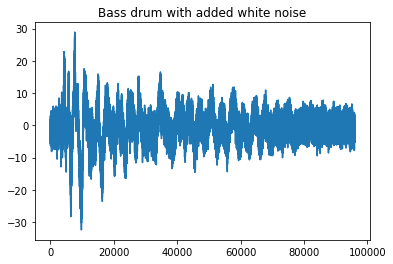

In [30]:
plt.plot(data0_wn)
plt.title("Bass drum with added white noise")
plt.show()
ipd.Audio(data0_wn, rate=data[0].rate)

In [33]:
white_noise_dataset = []
for i in range(10):
    white_noise_dataset.append(data[0].data + white_noise(data_len, 0, 0.175*i))

In [34]:
white_noise_dataset

[array([-1., -1., -1., ..., -1.,  0., -2.]),
 array([-0.84998487, -0.77848834, -1.08615212, ..., -0.99904331,
        -0.09889334, -2.01326718]),
 array([-1.05505206, -1.0231117 , -1.1635224 , ..., -1.15151685,
         0.11893347, -1.96081144]),
 array([-1.7326145 , -0.73548402, -1.30758248, ..., -1.27330998,
         0.72144018, -1.72648874]),
 array([-1.74550839, -0.98415702, -1.53119867, ...,  0.17713291,
         0.63648851, -2.68152882]),
 array([-2.02932291, -1.6756907 , -2.18779096, ..., -0.67792941,
        -0.90151865, -0.85476224]),
 array([-1.45568223, -0.88844463, -0.48880012, ...,  0.61790637,
         1.40608978, -0.00978273]),
 array([ 0.18685926, -0.26142191, -0.41173625, ..., -1.16904021,
        -1.35132026, -0.73318605]),
 array([-1.15299673, -3.26895819,  0.73472816, ...,  0.58998689,
         0.3195368 ,  0.75727922]),
 array([-0.26121549, -1.7090901 ,  2.71362543, ...,  3.48603357,
        -0.98864425, -4.6987872 ])]

In [36]:
ipd.Audio(white_noise_dataset[9], rate=data[0].rate)

In [37]:
ipd.Audio(white_noise_dataset[0], rate=data[0].rate)

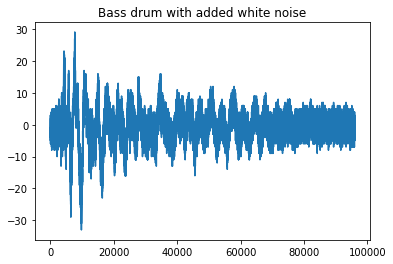

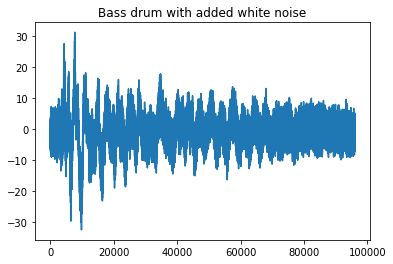

In [43]:
plt.plot(white_noise_dataset[0])
plt.title("Bass drum with added white noise")
plt.show()
plt.plot(white_noise_dataset[9])
plt.title("Bass drum with added white noise")
plt.show()
ipd.Audio(white_noise_dataset[9], rate=data[0].rate)

In [41]:
## Reducing noise
reduced_noise_dataset = []
for i in range(10):
    reduced_noise_dataset.append(savgol_filter(data[0].data, 100*(i+1)+1, 2))
    

c:\users\danzi\appdata\local\programs\python\python35\lib\site-packages\scipy\signal\_arraytools.py:45: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  b = a[a_slice]


In [62]:
def data_aug_reduce_noise(samples, window_i):
    return savgol_filter(samples, 100*(i+1)+1, 2)

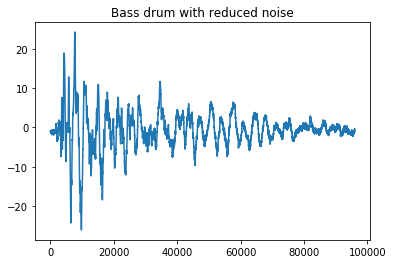

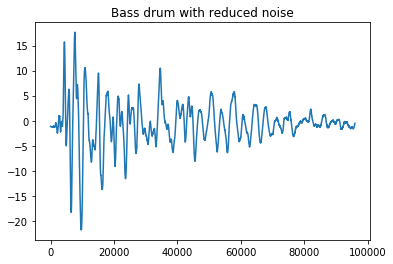

In [44]:
plt.plot(reduced_noise_dataset[0])
plt.title("Bass drum with reduced noise")
plt.show()
plt.plot(reduced_noise_dataset[9])
plt.title("Bass drum with reduced noise")
plt.show()

In [47]:
ipd.Audio(reduced_noise_dataset[2], rate=data[0].rate)

In [46]:
ipd.Audio(reduced_noise_dataset[9], rate=data[0].rate)

In [61]:
def data_aug_amplitude(samples, target_amplitude):
    highest_amplitude = np.amax(samples)
    multiplier = target_amplitude/highest_amplitude
    return samples*multiplier

In [70]:
alter_amplitude_data_set = []
for i in range(20):
    amplitude = (i+1)
    alter_amplitude_data_set.append(data_aug_amplitude(data[0].data, amplitude))

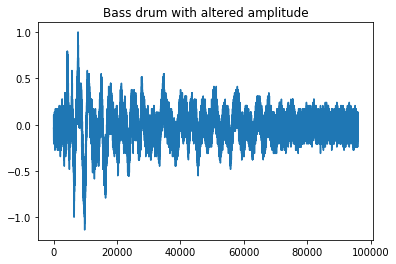

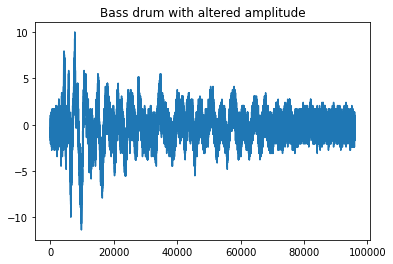

In [71]:
plt.plot(alter_amplitude_data_set[0])
plt.title("Bass drum with altered amplitude")
plt.show()
plt.plot(alter_amplitude_data_set[9])
plt.title("Bass drum with altered amplitude")
plt.show()

In [72]:
ipd.Audio(alter_amplitude_data_set[0], rate=data[0].rate)

In [74]:
ipd.Audio(alter_amplitude_data_set[19], rate=data[0].rate)

In [60]:
def data_aug_pitch_shift(samples, pitch_diff, sample_rate):
    if (type(samples) is not np.float32):
        samples = np.float32(samples)
    return librosa.effects.pitch_shift(y=samples, sr=sample_rate, n_steps=pitch_diff)

In [10]:
alter_pitch_data_set = []
for i in range(-10, 10):
    pitch_diff = i
    if i < 0:
        pitch_diff -= 1
    else:
        pitch_diff += 1
    alter_pitch_data_set.append(data_aug_pitch_shift(data[0].data, data[0].rate, pitch_diff))

In [11]:
ipd.Audio(alter_pitch_data_set[0], rate=data[0].rate)

In [12]:
ipd.Audio(alter_pitch_data_set[10], rate=data[0].rate)

In [13]:
ipd.Audio(alter_pitch_data_set[19], rate=data[0].rate)

In [4]:
### Data Augmentation

def white_noise(amount, mu, sigma_squared):
    return sigma_squared*np.random.randn(amount)+mu

def data_aug_white_noise(samples, noise_amp):
    return samples + white_noise(len(samples), 0, 0.175*(noise_amp+1))

def data_aug_reduce_noise(samples, window_i):
    return savgol_filter(samples, 100*(i+1)+1, 2)

def data_aug_amplitude(samples, target_amplitude):
    highest_amplitude = np.amax(samples)
    multiplier = target_amplitude/highest_amplitude
    return samples*multiplier

def data_aug_pitch_shift(samples, pitch_diff, sample_rate):
    if (type(samples) is not np.float32):
        samples = np.float32(samples)
    return librosa.effects.pitch_shift(y=samples, sr=sample_rate, n_steps=pitch_diff)

augmentations = {"amplitude": data_aug_amplitude, "pitch": data_aug_pitch_shift, "add_noise": data_aug_white_noise, "reduce_noise": data_aug_reduce_noise}

In [38]:
[list(augmentations.keys())] + [[c1, c2] for c1, c2 in permutations(augmentations.keys(), 2)] + [[c1, c2, c3] for c1, c2, c3 in permutations(augmentations.keys(), 3)]

[['amplitude', 'reduce_noise', 'pitch', 'add_noise'],
 ['amplitude', 'reduce_noise'],
 ['amplitude', 'pitch'],
 ['amplitude', 'add_noise'],
 ['reduce_noise', 'amplitude'],
 ['reduce_noise', 'pitch'],
 ['reduce_noise', 'add_noise'],
 ['pitch', 'amplitude'],
 ['pitch', 'reduce_noise'],
 ['pitch', 'add_noise'],
 ['add_noise', 'amplitude'],
 ['add_noise', 'reduce_noise'],
 ['add_noise', 'pitch'],
 ['amplitude', 'reduce_noise', 'pitch'],
 ['amplitude', 'reduce_noise', 'add_noise'],
 ['amplitude', 'pitch', 'reduce_noise'],
 ['amplitude', 'pitch', 'add_noise'],
 ['amplitude', 'add_noise', 'reduce_noise'],
 ['amplitude', 'add_noise', 'pitch'],
 ['reduce_noise', 'amplitude', 'pitch'],
 ['reduce_noise', 'amplitude', 'add_noise'],
 ['reduce_noise', 'pitch', 'amplitude'],
 ['reduce_noise', 'pitch', 'add_noise'],
 ['reduce_noise', 'add_noise', 'amplitude'],
 ['reduce_noise', 'add_noise', 'pitch'],
 ['pitch', 'amplitude', 'reduce_noise'],
 ['pitch', 'amplitude', 'add_noise'],
 ['pitch', 'reduce_nois

In [52]:
# Permutations of 2 or more length of augmentation operations.
aug_stack =  [[c1, c2] for c1, c2 in permutations(augmentations.keys(), 2)] + [[c1, c2, c3] for c1, c2, c3 in permutations(augmentations.keys(), 3)] + [list(augmentations.keys())]
aug_stack = aug_stack + [[aug] for aug in augmentations.keys()]
aug_data = collections.OrderedDict([("-".join(stack), []) for stack in aug_stack])
print(aug_data, len(aug_data))

OrderedDict([('amplitude-reduce_noise', []), ('amplitude-pitch', []), ('amplitude-add_noise', []), ('reduce_noise-amplitude', []), ('reduce_noise-pitch', []), ('reduce_noise-add_noise', []), ('pitch-amplitude', []), ('pitch-reduce_noise', []), ('pitch-add_noise', []), ('add_noise-amplitude', []), ('add_noise-reduce_noise', []), ('add_noise-pitch', []), ('amplitude-reduce_noise-pitch', []), ('amplitude-reduce_noise-add_noise', []), ('amplitude-pitch-reduce_noise', []), ('amplitude-pitch-add_noise', []), ('amplitude-add_noise-reduce_noise', []), ('amplitude-add_noise-pitch', []), ('reduce_noise-amplitude-pitch', []), ('reduce_noise-amplitude-add_noise', []), ('reduce_noise-pitch-amplitude', []), ('reduce_noise-pitch-add_noise', []), ('reduce_noise-add_noise-amplitude', []), ('reduce_noise-add_noise-pitch', []), ('pitch-amplitude-reduce_noise', []), ('pitch-amplitude-add_noise', []), ('pitch-reduce_noise-amplitude', []), ('pitch-reduce_noise-add_noise', []), ('pitch-add_noise-amplitude', 

In [ ]:
aug_keys = list(aug_data.keys())
stacks = len(aug_keys)
augmented_data = []
data_size = len(data)
for j in range(data_size):
    print("Processing augmented data - {}/{}".format(j, data_size))
    # Process augmentation stacks of data in batches
    processing_start_time = time.time()
    for d in data[j*4:(j+1)*4]:
        aug_data = collections.OrderedDict([("-".join(stack), []) for stack in aug_stack])
        for s in range(stacks):
            stack_key = aug_keys[s]
            aug_samples = d.data
            for aug in aug_stack[s]:
                for i in range(10):
                    args = []
                    var = i+1
                    if aug == "amplitude":
                        var = np.amax(d.data)
                        var = var - (5-i)*5 if i < 5 else var + (i-4)*5
                    if aug == "pitch":
                        args = [d.rate]
                        var = i - 5 if i < 5 else i - 4
                    aug_samples = augmentations[aug](aug_samples, var, *args)
            aug_data[stack_key].append(aug_samples)
        augmented_data.append((aug_data, d.labels, d.rate))
    processing_end_time = time.time()
    print("\tExecuted in: {}\nSaving augmented data - {}/{}".format(round(processing_end_time-processing_start_time, 2), j, data_size))
    # Save augmented data in batches
    for aug_data, labels, rate in augmented_data[j*4:(j+1)*4]:
        subdirs = [labels[label] for label in SETTINGS.dir_structure]
        for aug in aug_keys:
            path = os.path.join(SETTINGS.data_paths["preprocessed"], aug, *subdirs)
            for samples in aug_data[aug]:
                save(path, np.array(samples, dtype=np.int16), rate)
    saving_end_time = time.time()
    print("\tExecuted in:", round(saving_end_time-processing_end_time, 2))

Processing augmented data - 0/335


c:\users\danzi\appdata\local\programs\python\python35\lib\site-packages\scipy\signal\_arraytools.py:45: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  b = a[a_slice]


	Executed in: 191.29
Saving augmented data - 0/335
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio


Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
	Executed in: 1.04
Processing augmented data - 4/335
	Executed in: 193.27
Saving augmented data - 4/335
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio
Saving audio

In [54]:
ipd.Audio(data[3].data, rate=data[3].rate)

In [8]:
ipd.Audio(augmented_data[0][0]["pitch"][9], rate=augmented_data[0][2])

In [9]:
ipd.Audio(augmented_data[0][0]["add_noise"][9], rate=data[0].rate)

In [10]:
ipd.Audio(augmented_data[0][0]["reduce_noise"][9], rate=data[0].rate)

In [18]:
ipd.Audio(data[30].data, rate=data[30].rate)

In [29]:
ipd.Audio(augmented_data[30][0]["pitch"][0], rate=data[30].rate)

In [24]:
ipd.Audio(augmented_data[30][0]["add_noise"][9], rate=data[30].rate)

In [27]:
ipd.Audio(augmented_data[30][0]["reduce_noise"][0], rate=data[30].rate)

In [8]:
ipd.Audio(np.array(augmented_data[0][0]["reduce_noise"][9], dtype=np.int16), rate=data[30].rate)

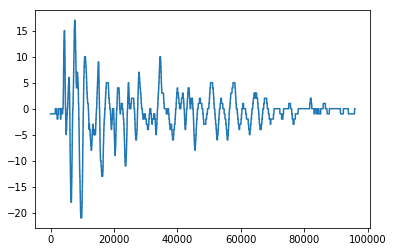

In [7]:
plt.plot(np.array(augmented_data[0][0]["reduce_noise"][9], dtype=np.int16))
plt.show()

In [22]:
save(os.path.join("preprocessed_data", "test"), np.array(augmented_data[3][0]["reduce_noise"][9], dtype=np.int16), data[3].rate)

Saving audio


True

In [6]:
save(os.path.join("preprocessed_data", "test"), data[0].data, data[0].rate)

Saving audio


True

In [4]:
data[0].data

array([-1, -1, -1, ..., -1,  0, -2], dtype=int16)

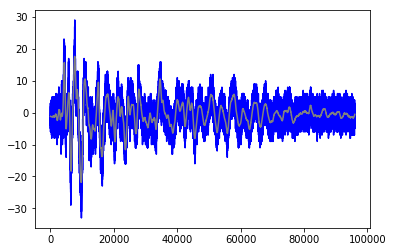

In [8]:
plt.plot(data[0].data, color="blue")
plt.plot(augmented_data[0][0]["reduce_noise"][9], color="grey")
plt.show()

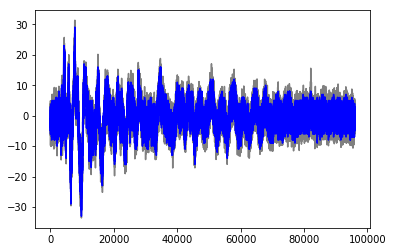

In [10]:
plt.plot(augmented_data[0][0]["add_noise"][9], color="grey")
plt.plot(data[0].data, color="blue")
plt.show()

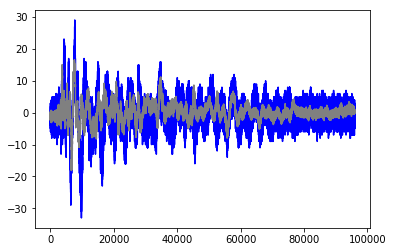

In [14]:
plt.plot(data[0].data, color="blue")
plt.plot(augmented_data[0][0]["pitch"][9], color="grey")
plt.show()

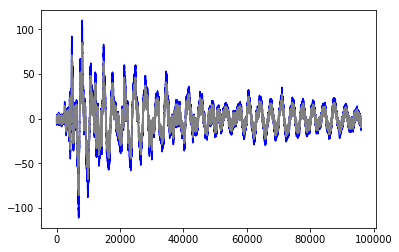

In [29]:
plt.plot(data[3].data, color="blue")
plt.plot(augmented_data[3][0]["amplitude"][0], color="grey")
plt.show()

In [13]:
a = np.array([{"amplitude": [data[j].data.tolist() for j in range(3)], "pitch": [data[j].data.tolist() for j in range(3)], "add_noise": [data[j].data.tolist() for j in range(3)], "reduce_noise": [data[j].data.tolist() for j in range(3)]} for i in range(4)])

In [14]:
a

array([{'pitch': [[-1, -1, -1, -2, 1, 0, -3, 3, -5, 2, -1, -2, 1, -3, 0, 0, -5, 2, -3, 0, -2, -1, -3, 2, -4, -1, -1, -2, -2, -1, -4, -1, -2, -2, -2, 0, -4, 2, -6, 1, -2, -2, 1, -3, 0, -2, -1, -2, -2, 1, -3, 2, -2, -1, 1, -2, 0, 1, -2, 2, -1, 0, 1, -3, 1, -2, -2, -2, -1, -4, 2, -4, 0, -2, -2, -1, -1, -3, 1, -4, 0, -4, 0, -4, 0, -4, 0, -1, -4, 1, -3, 0, 0, 1, -1, 0, 0, -3, 3, -3, 1, -1, -3, 0, -3, -2, -2, -3, -3, -1, -4, 1, -5, 0, -3, 1, -2, -1, -1, -1, 0, -1, -1, -2, 0, -3, 0, -1, -3, 1, -4, 1, -4, -1, -1, -2, 0, -3, 1, -2, 2, -5, 2, -4, 0, -2, -1, -2, -1, -3, -1, -2, -2, -3, -1, -2, -3, 0, -4, -2, 1, -4, 2, -3, 1, -5, 2, -3, 0, 0, -2, 1, -1, 0, 2, -3, 1, 0, -2, 3, -5, 2, -3, 0, -2, 0, -2, -3, 1, -4, 2, -4, 1, -3, 2, -3, -1, 1, -4, 2, -5, 2, -4, 2, -4, -2, 0, -3, 0, -4, -2, 0, -5, 2, -6, 2, -3, 0, -1, -1, -2, 0, -1, -2, 1, -5, 2, -4, 1, -4, -2, -1, -3, 0, -1, -2, 1, -2, 0, -1, -2, 1, -3, 2, -3, 0, 0, 0, 0, 0, 0, 1, 0, -1, 2, -2, 2, -2, 2, -3, 1, -1, -1, 2, -5, 2, -2, -2, 2, -6, 4, -4, 0

In [15]:
np.savetxt(fname=os.path.join(os.getcwd(), "preprocessed_data", "data.gz"), X=a, fmt="%s")